## Get prediction

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt

import sys
import numpy as np
import torch

sys.path.insert(0, '..')
from isegm.ritm.utils import vis, exp

from isegm.inference import utils
from isegm.ritm.inference.evaluation_explainable import evaluate_sample
from isegm.ritm.inference.predictors import get_predictor
from isegm.ritm.model.is_explainable_ritm_hrnet_model import RitmHRNetModelExplainable
from isegm.data.preprocess import Preprocessor
from isegm.inference.clicker import Clicker, DynamicClicker

device = torch.device('cuda:0')
cfg = exp.load_config_file('config.yml', return_edict=True)

In [2]:
EVAL_MAX_CLICKS = 20
MODEL_THRESH = 0.5
TRAINING_OUTPUT_PATH = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training'

# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-ritm_standard_aug')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-ritm_standard big_dataset')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-dynamic_clicks big dataset')
checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-KITS23_2D_TUMOURS-Static disks')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-KITS23_2D_TUMOURS-Dynamic disks')
# checkpoint_path = utils.find_checkpoint_from_training(TRAINING_OUTPUT_PATH, 'RITM-KITS23_2D_TUMOURS-Static disks')
# checkpoint_path = '/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/2024-02-03/11-59-20-RITM-ONE_SAMPLE Dynamic clicks unlocked backbone unlocked click head/checkpoints/best_model.pth'
print(checkpoint_path)

saved_model = utils.load_is_model(checkpoint_path, 'cpu', model_type='RITM')

# saved_model = utils.load_is_model(checkpoint_path, 'cpu', train_config=train_config)
saved_model = saved_model.to('cpu')
model = RitmHRNetModelExplainable(
        pipeline_version='s2',
        width=32,
        ocr_width=128,
        small=False,
        with_aux_output=True,
        use_leaky_relu=True,
        use_rgb_conv=False,
        use_disks=True,
        norm_radius=5,
        with_prev_mask=True,
        dynamic_radius_points=False,
        overwrite_click_maps=False
    )
model.load_state_dict(saved_model.state_dict())
model = model.to(device)
model.eval()

# Possible choices: 'NoBRS', 'f-BRS-A', 'f-BRS-B', 'f-BRS-C', 'RGB-BRS', 'DistMap-BRS'
# brs_mode = 'NoBRS'
brs_mode = 'NoBRSExplainable'

# zoom_in_params = None
zoom_in_params = dict()
zoom_in_params['recompute_click_size_on_zoom']=False
# zoom_in_params['skip_clicks'] = 0

predictor = get_predictor(model, brs_mode, device, prob_thresh=MODEL_THRESH, zoom_in_params=zoom_in_params) 

/gpfs/space/projects/PerkinElmer/donatasv_experiments/repos/ClickSEG/outputs/training/2024-03-06/16-12-02-RITM-KITS23_2D_TUMOURS-Static disks/checkpoints/best_model.pth
Model args: {'width': 32, 'ocr_width': 128, 'with_aux_output': True, 'use_leaky_relu': True, 'use_rgb_conv': False, 'dist_map_mode': 'disk', 'norm_radius': 5, 'with_prev_mask': True, 'overwrite_click_maps': False, 'model_type': 'RITM'}


In [11]:
# Possible choices: 'DAVIS', 'BRATS', 'LIDC', 'LIDC_2D_VAL', 'LIDC_2D_256_VAL', 'LIDC_CROPS_BOXED', 'LIDC_CROPS_WHITENED', 'LIDC_CROPS'
# DATASET = 'LIDC_2D_FULL_VAL'
# preprocessor = Preprocessor()
# preprocessor.normalize = True
# preprocessor.windowing = True
# preprocessor.window_min = -900
# preprocessor.window_max = 600
# DATASET = 'KITS23_2D_TUMOURS_VAL'
# DATASET = 'LITS_2D_VAL'
# DATASET = 'MD_PANC_2D_VAL'
DATASET = 'COMBINED_2D_VAL'
preprocessor = Preprocessor()
preprocessor.normalize = False
preprocessor.windowing = False
preprocessor.num_input_channels = 1
preprocessor.window_min = -45
preprocessor.window_max = 105

dataset = utils.get_dataset(DATASET, cfg, preprocessor=preprocessor)

In [12]:
len(dataset)

48

[0.591 0.654 0.739 0.765 0.795 0.819 0.838 0.851 0.86  0.868 0.893 0.881
 0.901 0.91  0.915 0.927 0.928 0.928 0.927 0.92 ]


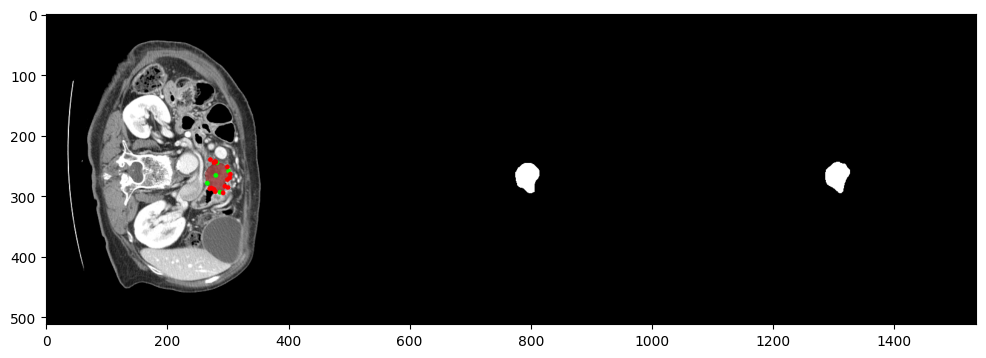

In [21]:
sample_id =  36#43 #14 #51, 35
TARGET_IOU = 1

use_init_mask = False

sample = dataset.get_sample(sample_id)

gt_mask = sample.gt_mask
image = sample.image
init_mask = np.zeros_like(gt_mask)

if use_init_mask and sample.init_mask is not None:
    init_mask = sample.init_mask

#mode = min, avg, max, distributed, locked
clicker = DynamicClicker(gt_mask, mode='locked')

predictor.set_prev_mask(init_mask)

clicks_list, ious_arr, pred, pred_list, info_list = evaluate_sample(image, gt_mask, predictor, clicker,
                                              pred_thr=MODEL_THRESH, 
                                              max_iou_thr=TARGET_IOU, max_clicks=EVAL_MAX_CLICKS)

pred_mask = pred_list[-1] > MODEL_THRESH
draw = vis.draw_with_blend_and_clicks(image, mask=pred_mask, clicks_list=clicks_list)
draw = np.concatenate((draw,
    255 * pred_mask[:, :, np.newaxis].repeat(3, axis=2),
    255 * (gt_mask > 0)[:, :, np.newaxis].repeat(3, axis=2)
), axis=1)
print(np.round(ious_arr, 3))
plt.figure(figsize=(12, 18))
plt.imshow(draw)
plt.show()

# Visualise progression graph:

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64

def show_animation(animation):
    html = animation.to_jshtml()
    return HTML(html)

def save_animation(animation, filename):
    animation.save(f'{filename}.gif', writer='pillow')

def generate_click_animation(image, gt_mask, iou_values, pos_click_maps, neg_click_maps, predictions):
    rows = np.any(gt_mask, axis=1)
    cols = np.any(gt_mask, axis=0)
    ymin, ymax = np.where(rows)[0][[0, -1]]
    xmin, xmax = np.where(cols)[0][[0, -1]]

    box_height = ymax - ymin
    box_width = xmax - xmin
    max_side = max(box_height, box_width) * 5

    center_y = ymin + box_height // 2
    center_x = xmin + box_width // 2
    half_side = max_side // 2

    square_ymin = max(0, center_y - half_side)
    square_ymax = min(image.shape[0], center_y + half_side)
    square_xmin = max(0, center_x - half_side)
    square_xmax = min(image.shape[1], center_x + half_side)

    fig, ax = plt.subplots(1, 4, figsize=(24, 8))

    iou_values = np.append(np.array([0]), iou_values)
    num_frames = len(predictions)
    # num_frames = 1
    
    for a in ax[:3]:
        a.axis('off')
        a.set_xlim(square_xmin, square_xmax)
        a.set_ylim(square_ymax, square_ymin)
        a.imshow(image, cmap='gray')
    
    ax[0].set_title('Initial', fontsize=20)
    ax[1].set_title(f'IOU: {iou_values[0]:.3f}', fontsize=20)

    ax[2].set_xticks(np.arange(1, len(iou_values) + 1))
    ax[2].set_ylim(0, 1.05)
    ax[2].set_xlabel('Clicks')
    ax[2].set_ylabel('IOU')
    ax[2].set_title('IOU after each click', fontsize=20)
    
    plt.close()
    
    def update(frame_index):
        for a in ax[:3]:
            a.imshow(image, cmap='gray')
            a.set_xlim(square_xmin, square_xmax)
            a.set_ylim(square_ymax, square_ymin)
        ax[0].set_title(f'Input', fontsize=20)

        ax[1].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        
        # Add contour of ground truth mask
        ax[1].contour(gt_mask, colors='w', levels=[0.5])  # Drawing contour in white color
        
        # Overlay for positive clicks
        pos_click_map = pos_click_maps[frame_index]
        pos_overlay = np.ma.masked_where(pos_click_map == 0, pos_click_map)
        ax[1].imshow(np.dstack((np.zeros_like(pos_overlay), pos_overlay, np.zeros_like(pos_overlay), pos_overlay*0.5)), interpolation='nearest')

        # Overlay for negative clicks
        neg_click_map = neg_click_maps[frame_index]
        neg_overlay = np.ma.masked_where(neg_click_map == 0, neg_click_map)
        ax[1].imshow(np.dstack((neg_overlay, np.zeros_like(neg_overlay), np.zeros_like(neg_overlay), neg_overlay*0.5)), interpolation='nearest')

        if frame_index < len(predictions):
            prediction_masked = np.ma.masked_where(predictions[frame_index] == 0, predictions[frame_index])
            ax[2].imshow(prediction_masked, alpha=0.5, cmap='gist_rainbow')
            ax[2].set_title(f'IOU: {iou_values[frame_index + 1]:.3f}', fontsize=20)
            
        ax[3].plot(np.arange(frame_index + 2), iou_values[:frame_index + 2], color='b')
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

def extract_click_maps(info_list):
    pos_click_maps = []
    neg_click_maps = []
    for info in info_list:
        pos_click_maps.append(info['coarse_seg']['click_map'][0, 0].cpu().numpy())
        neg_click_maps.append(info['coarse_seg']['click_map'][0, 1].cpu().numpy())
    return pos_click_maps, neg_click_maps

pos_click_maps, neg_click_maps = extract_click_maps(info_list)

anim = generate_click_animation(image[:, :, 0], gt_mask, ious_arr, pos_click_maps, neg_click_maps, pred_list)
show_animation(anim)

In [42]:
pos_click_maps, neg_click_maps = extract_click_maps(info_list)

anim = generate_click_animation(image[:, :, 0], gt_mask, ious_arr, pos_click_maps, neg_click_maps, pred_list)
show_animation(anim)

# Visualise each part

In [8]:
step_info = info_list[1]

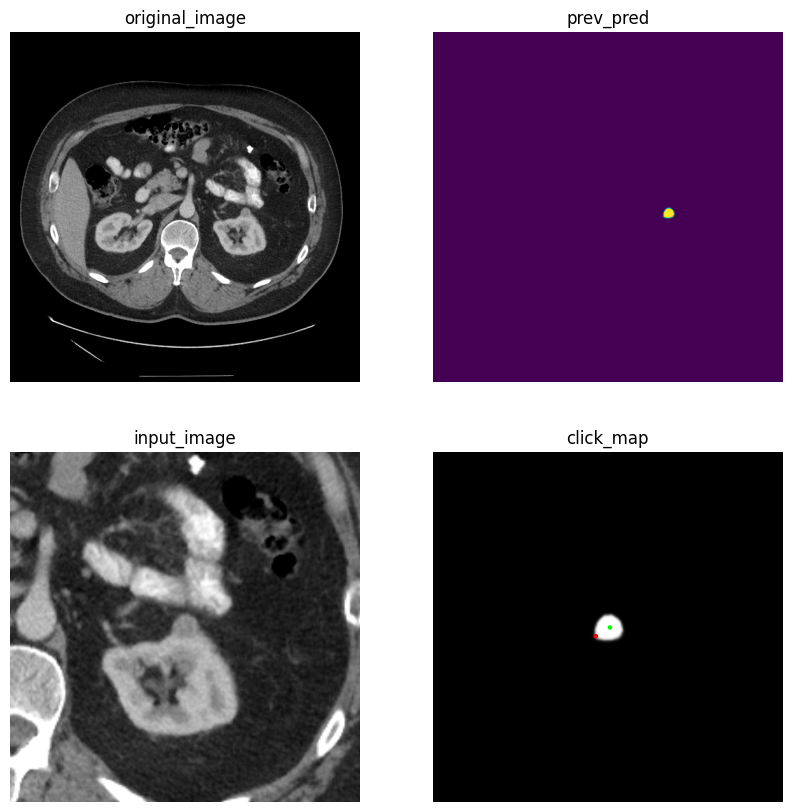

In [9]:
def show_before_coarse(info):
    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.close()
    
    ax[0,0].set_title('original_image')
    ax[0,0].imshow(info['original_image'][0], cmap='gray')
    ax[0,0].axis('off')
    
    ax[0,1].set_title('prev_pred')
    ax[0,1].imshow(info['prev_mask'])
    ax[0,1].axis('off')
    
    ax[1,0].set_title(f'input_image')
    ax[1,0].imshow(info['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
    ax[1,0].axis('off')
    
    ax[1,1].set_title('click_map')
    ax[1,1].imshow(info['image_transforms']['image_nd'].cpu()[0, 3], cmap='gray')
    ax[1,1].axis('off')
    
    y = [click.coords[0] for click in info['image_transforms']['clicks_lists'][0]]
    x = [click.coords[1] for click in info['image_transforms']['clicks_lists'][0]]
    c = [click.is_positive for click in info['image_transforms']['clicks_lists'][0]]
    c = ['lime' if i else 'red' for i in c]
    
    ax[1,1].scatter(x, y, c=c, s=5)
    
    return fig

show_before_coarse(step_info)

In [10]:
step_info['image_transforms']['clicks_lists'][0]

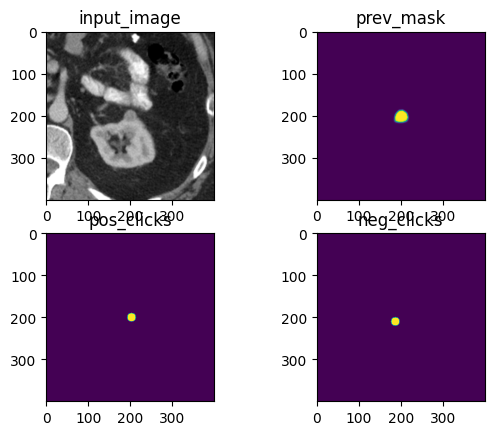

In [11]:
def show_coarse_input(info):
    
    info = info['coarse_seg']
    
    fig, ax = plt.subplots(2, 2)
    plt.close()
    
    ax[0, 0].set_title('input_image')
    ax[0, 0].imshow(info['prepared_input']['image'].cpu()[0, 0], cmap='gray')
    
    ax[0, 1].set_title('prev_mask')
    ax[0, 1].imshow(info['prepared_input']['prev_mask'].cpu()[0, 0])
    
    ax[1, 0].set_title('pos_clicks')
    ax[1, 0].imshow(info['click_map'].cpu()[0, 0])
    
    ax[1, 1].set_title('neg_clicks')
    ax[1, 1].imshow(info['click_map'].cpu()[0, 1])
    
    return fig

show_coarse_input(step_info)

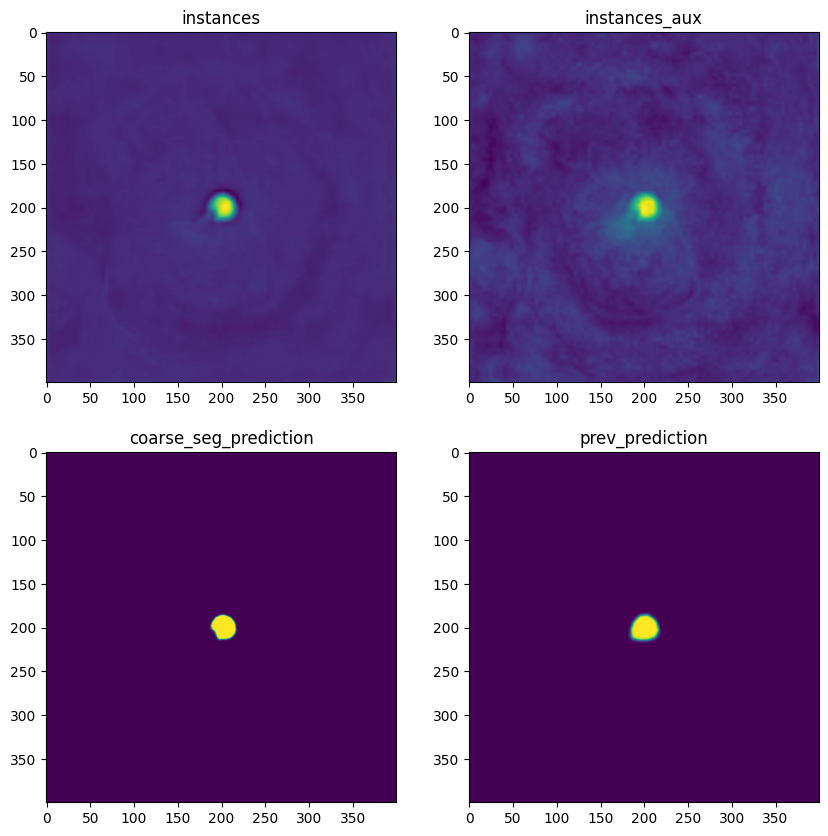

In [12]:
def show_coarse_predictions(info):

    fig, ax = plt.subplots(2, 2, figsize=(10, 10))
    plt.close()
    
    ax[0, 0].set_title('instances')
    ax[0, 0].imshow(info['coarse_seg']['outputs']['instances'].cpu()[0, 0])
    
    ax[0, 1].set_title('instances_aux')
    ax[0, 1].imshow(info['coarse_seg']['outputs']['instances_aux'].cpu()[0, 0])
    
    ax[1, 0].set_title('coarse_seg_prediction')
    new_mask = torch.sigmoid(info['coarse_seg']['outputs']['instances'].cpu()[0, 0]).numpy()
    ax[1, 0].imshow(new_mask)
    
    ax[1,1].set_title('prev_prediction')
    ax[1,1].imshow(info['coarse_seg']['prepared_input']['prev_mask'].cpu()[0, 0])
    
    return fig

show_coarse_predictions(step_info)

# Animation code

In [18]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import base64
from isegm.ritm.inference.transforms.zoom_in import get_roi_image_nd
    
def generate_click_animation(image, gt_mask, iou_values, clicks, predictions, info_list):
    fig, ax = plt.subplots(2, 3, figsize=(9, 7))
    if len(image.shape) == 3:
        image = image[:, :, 0]
        
    num_frames = len(clicks)
        
    ax[0,0].imshow(image, cmap='gray')
    ax[0,0].axis('off')
    ax[0,0].set_title('Image, gt mask,\nClicks', fontsize=20)
    ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)

    ax[1, 1].set_title('Coarse logits')
    
    plt.close()
    
    def update(frame_index):
        
        fig.suptitle(f'Click {frame_index + 1}', fontsize=20)
        
        ax[0,0].imshow(image, cmap='gray')
        ax[0,0].set_title(f'Clicks: {frame_index + 1}', fontsize=20)
        ax[0,0].contour(gt_mask, colors='b', alpha=0.5, linewidths=0.1)
        for click in clicks[:frame_index + 1]:
            color = 'lime' if click.is_positive else 'r'
            y, x = click.coords
            ax[0,0].scatter(x, y, s=10, c=color)
            
        ax[0,1].clear()
        ax[0,1].set_title('Previous predicition', fontsize=20)
        ax[0,1].axis('off')
        ax[0,1].imshow(info_list[frame_index]['prev_mask'])
        
        ax[0,2].clear()
        ax[0,2].axis('off')
        ax[0,2].set_title(f'Input image', fontsize=20)
        ax[0,2].imshow(info_list[frame_index]['image_transforms']['image_nd'].cpu()[0, 0], cmap='gray')
        
        image_transforms = info_list[frame_index]['image_transforms']
        click_map = image_transforms['image_nd'].cpu()[0, 3]
        coarse_seg = info_list[frame_index]['coarse_seg']
        pos_clicks = coarse_seg['click_map'].cpu()[0, 0]
        neg_clicks = coarse_seg['click_map'].cpu()[0, 1]
        
        
        roi = info_list[frame_index]['image_transforms']['roi']
        if frame_index != 0:
            cropped_mask = get_roi_image_nd(torch.tensor(gt_mask).float().unsqueeze(0).unsqueeze(0), roi, click_map.shape)
            cropped_mask = cropped_mask.squeeze(0).squeeze(0)
        else:
            cropped_mask = gt_mask
        
        ax[1,0].clear()
        ax[1,0].set_title('Click map', fontsize=20)
        ax[1,0].axis('off')
        ax[1,0].imshow(image_transforms['image_nd'].cpu()[0, 3], cmap='gray')
        ax[1,0].contour(cropped_mask, colors='b', alpha=0.5, linewidths=0.2)
        pos_masked = np.ma.masked_where(pos_clicks == 0, pos_clicks)
        ax[1,0].imshow(pos_masked, cmap='summer')
        neg_masked = np.ma.masked_where(neg_clicks == 0, neg_clicks)
        ax[1,0].imshow(neg_masked, cmap='autumn')
        
        # ax[1,0].imshow(pos_overlay, alpha=0.8)
        # ax[1,0].imshow(neg_overlay, alpha=0.5)
        
        
        
        ax[1,1].clear()
        ax[1,1].set_title('Prediction', fontsize=20)
        ax[1,1].axis('off')
        ax[1,1].imshow(info_list[frame_index]['coarse_seg_prediction'])
        
        ax[1,2].clear()
        ax[1,2].axis('off')
        iou = str(np.round(iou_values[frame_index], 3))
        ax[1,2].set_title(f'Final mask (IoU: {iou})', fontsize=20)
        ax[1,2].imshow(predictions[frame_index])
        
        return
    
    animation = FuncAnimation(fig, update, frames=num_frames, interval=1000, blit=False)
    return animation

In [19]:
anim = generate_click_animation(image, gt_mask, ious_arr, clicks_list, pred_list, info_list)
show_animation(anim)

/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:446: UserWarning: Warning: converting a masked element to nan.
  dv = np.float64(self.norm.vmax) - np.float64(self.norm.vmin)
/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:453: UserWarning: Warning: converting a masked element to nan.
  a_min = np.float64(newmin)
/gpfs/space/home/donatasv/.conda/envs/bcv_clickseg/lib/python3.7/site-packages/matplotlib/image.py:458: UserWarning: Warning: converting a masked element to nan.
  a_max = np.float64(newmax)


TypeError: cannot unpack non-iterable NoneType object